<div >
<img src = "figs/ans_banner_1920x200.png" />
</div>

# Caso-taller:  Analizando el Delito en Chicago

En este caso-taller vamos a utilizar datos geográficos y estimación de densidad de kernel para analizar delitos en Chicago. Esta ciudad es muy famosa no sólo por haber sido el hogar del mafioso Al Capone, sino también por sus altas tasas de delitos. 

Para este taller obtuve datos del portal de la [ciudad de Chicago](https://www.chicago.gov/city/en/dataset/crime.html). La base de datos fue traducida y modificada para nuestras necesidades. Esta contiene todos los homicidios y robos que sucedieron entre el 1 de junio y el 31 de agosto de 2019.


## Instrucciones generales

1. Para desarrollar el *cuaderno* primero debe descargarlo.

2. Para responder cada inciso deberá utilizar el espacio debidamente especificado.

3. La actividad será calificada sólo si sube el *cuaderno* de jupyter notebook con extensión `.ipynb` en la actividad designada como "entrega calificada por el personal".

4. El archivo entregado debe poder ser ejecutado localmente por el tutor. Sea cuidadoso con la especificación de la ubicación de los archivos de soporte, guarde la carpeta de datos en el mismo `path` de su cuaderno, por ejemplo: `data`.

## Desarrollo


### 1.Carga de datos 

#### 1.1. Delitos

En la carpeta `data` se encuentra el archivo `Chicago_delitos_verano_2019.csv` cargue estos datos en su *cuaderno*. Describa brevemente el contenido de la base.

In [1]:
# Utilice este espacio para escribir el código.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
delitos = pd.read_csv('data/Chicago_delitos_verano_2019.csv')
delitos.head(3)

,fecha,tipo_crimen,nro_area_comunitaria,lat,lon
0,2019-06-01T05:07:00Z,homicidio,23,41.897950,-87.728625
1,2019-06-01T10:09:00Z,homicidio,71,41.753272,-87.648963
2,2019-06-01T12:46:00Z,homicidio,25,41.877622,-87.750728


In [3]:
delitos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17747 entries, 0 to 17746
Data columns (total 5 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fecha                 17747 non-null  object 
 1   tipo_crimen           17747 non-null  object 
 2   nro_area_comunitaria  17747 non-null  int64  
 3   lat                   17747 non-null  float64
 4   lon                   17747 non-null  float64
dtypes: float64(2), int64(1), object(2)
memory usage: 693.4+ KB


In [4]:
from datetime import datetime
import pytz

delitos['utc_time'] = pd.to_datetime(delitos['fecha'], utc= True)
delitos['utc_time'].dtype

datetime64[ns, UTC]

In [5]:
delitos['fecha_hora_local'] = delitos['utc_time'].dt.tz_convert('America/Chicago')

In [6]:
delitos.head(3)

,fecha,tipo_crimen,nro_area_comunitaria,lat,lon,utc_time,fecha_hora_local
0,2019-06-01T05:07:00Z,homicidio,23,41.897950,-87.728625,2019-06-01 05:07:00+00:00,2019-06-01 00:07:00-05:00
1,2019-06-01T10:09:00Z,homicidio,71,41.753272,-87.648963,2019-06-01 10:09:00+00:00,2019-06-01 05:09:00-05:00
2,2019-06-01T12:46:00Z,homicidio,25,41.877622,-87.750728,2019-06-01 12:46:00+00:00,2019-06-01 07:46:00-05:00


In [7]:
delitos['fecha_hora_local'].describe().T

count                                  17747
mean     2019-07-17 15:31:51.030596864-05:00
min                2019-06-01 00:00:00-05:00
25%                2019-06-25 06:25:00-05:00
50%                2019-07-18 13:45:00-05:00
75%                2019-08-08 19:00:00-05:00
max                2019-08-31 23:48:00-05:00
Name: fecha_hora_local, dtype: object

In [8]:
delitos['hora'] = delitos['fecha_hora_local'].dt.hour
delitos['dia'] = delitos['fecha_hora_local'].dt.day_name()

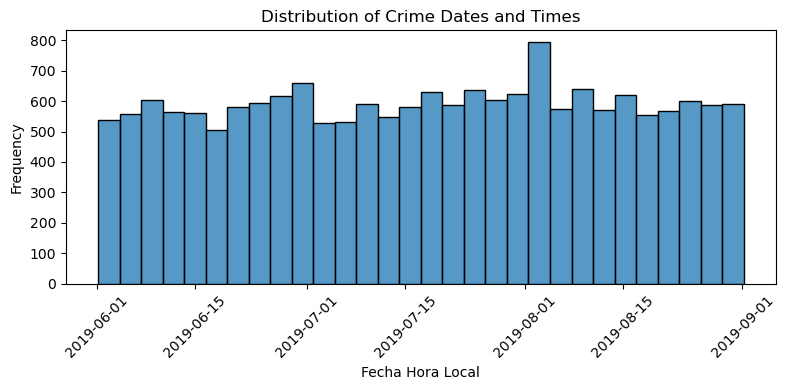

In [9]:
# Plot histogram
plt.figure(figsize=(8, 4))
sns.histplot(delitos['fecha_hora_local'], bins=30, kde=False)
plt.title('Distribution of Crime Dates and Times')
plt.xlabel('Fecha Hora Local')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

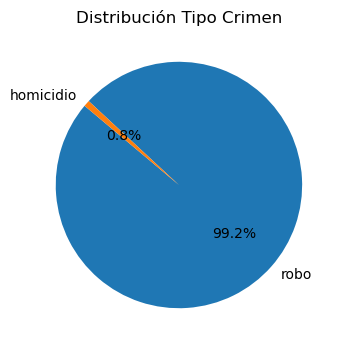

In [10]:
# Count the occurrences of each crime type
crime_counts = delitos['tipo_crimen'].value_counts()

# Plot the pie chart
plt.figure(figsize=(4, 4))
plt.pie(crime_counts, labels=crime_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribución Tipo Crimen')
plt.show()

In [11]:
# Separar df por robos y homicidios
datos_robo = delitos[delitos['tipo_crimen'] == 'robo']
datos_homicidio = delitos[delitos['tipo_crimen'] == 'homicidio']

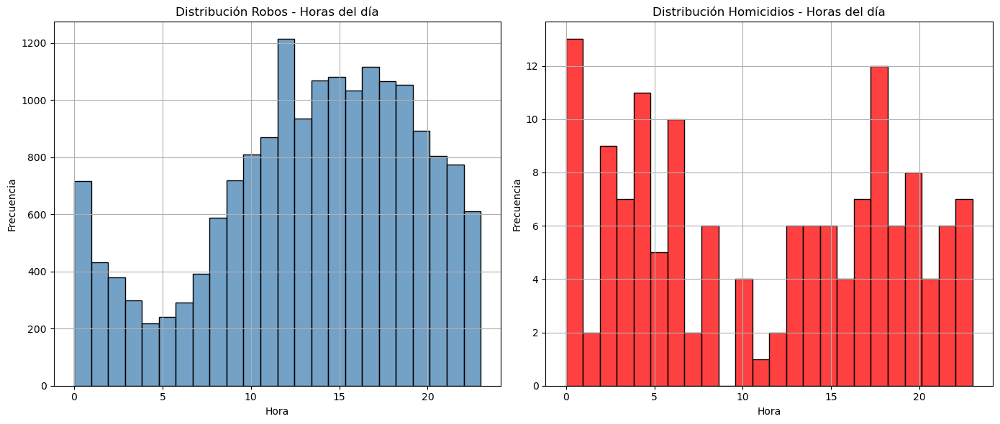

In [12]:
# Distribucion Tipo de Crimen por hora del dia
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

sns.histplot(datos_robo['hora'], bins=24, kde=False, ax=axs[0], color='steelblue')
axs[0].set_title('Distribución Robos - Horas del día')
axs[0].set_xlabel('Hora')
axs[0].set_ylabel('Frecuencia')
axs[0].grid(True)

sns.histplot(datos_homicidio['hora'], bins=24, kde=False, ax=axs[1], color='red')
axs[1].set_title('Distribución Homicidios - Horas del día')
axs[1].set_xlabel('Hora')
axs[1].set_ylabel('Frecuencia')
axs[1].grid(True)

plt.tight_layout()
plt.show()

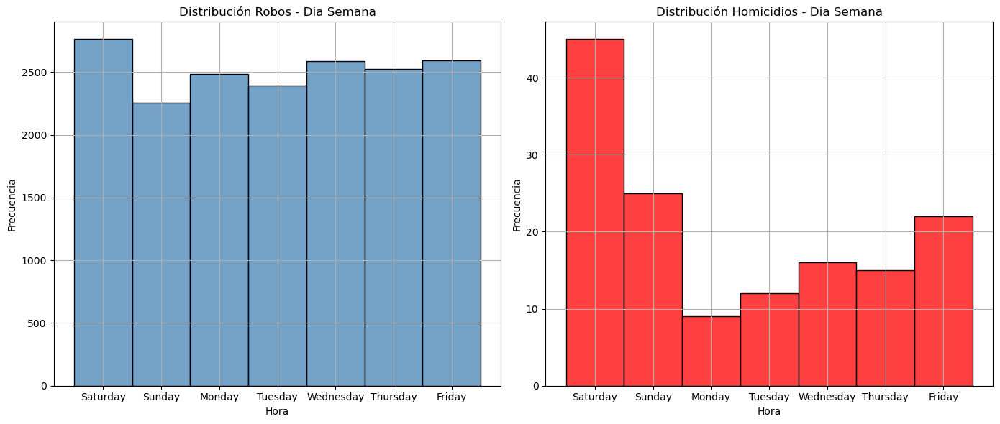

In [13]:
# Distribucion Tipo de Crimen por hora del dia
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

sns.histplot(datos_robo['dia'], bins=7, kde=False, ax=axs[0], color='steelblue')
axs[0].set_title('Distribución Robos - Dia Semana')
axs[0].set_xlabel('Hora')
axs[0].set_ylabel('Frecuencia')
axs[0].grid(True)

sns.histplot(datos_homicidio['dia'], bins=7, kde=False, ax=axs[1], color='red')
axs[1].set_title('Distribución Homicidios - Dia Semana')
axs[1].set_xlabel('Hora')
axs[1].set_ylabel('Frecuencia')
axs[1].grid(True)

plt.tight_layout()
plt.show()

In [14]:
delitos['nro_area_comunitaria'].describe()

count    17747.000000
mean        32.066546
std         21.440824
min          1.000000
25%         14.000000
50%         28.000000
75%         44.000000
max         77.000000
Name: nro_area_comunitaria, dtype: float64

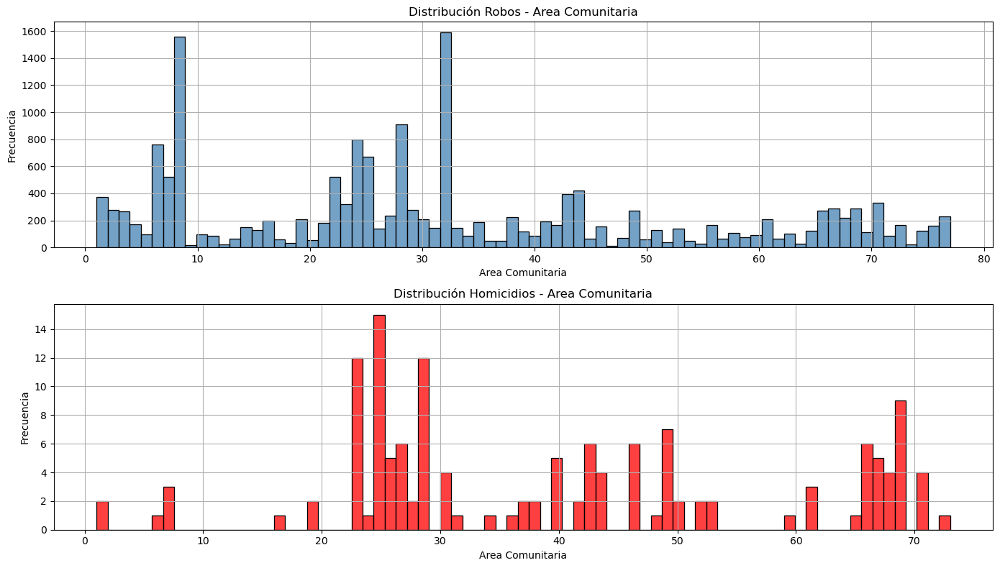

In [15]:
# Distribucion Tipo de Crimen por hora del dia
fig, axs = plt.subplots(2, 1, figsize=(14, 8))

sns.histplot(datos_robo['nro_area_comunitaria'], bins=77, kde=False, ax=axs[0], color='steelblue')
axs[0].set_title('Distribución Robos - Area Comunitaria')
axs[0].set_xlabel('Area Comunitaria')
axs[0].set_ylabel('Frecuencia')
axs[0].grid(True)

sns.histplot(datos_homicidio['nro_area_comunitaria'], bins=77, kde=False, ax=axs[1], color='red')
axs[1].set_title('Distribución Homicidios - Area Comunitaria')
axs[1].set_xlabel('Area Comunitaria')
axs[1].set_ylabel('Frecuencia')
axs[1].grid(True)

plt.tight_layout()
plt.show()

#### 1.2. Barrios de Chicago

También en la carpeta `data` se encuentran los archivos con los polígonos de las áreas comunitarias en un archivo comprimido llamado `Areas_comunitarias_Chicago.zip`. Genere un mapa interactivo con un popup con el nombre del area comunitaria.

In [16]:
# Utilice este espacio para escribir el código.
import geopandas as gpd
import folium
import zipfile
import os

# Descomprimir el archivo ZIP
#with zipfile.ZipFile('data/Areas_comunitarias_Chicago.zip', 'r') as zip_ref:
#    zip_ref.extractall('data/')

# Encontrar el archivo shapefile descomprimido
shp_file = [f for f in os.listdir('data/') if f.endswith('.shp')][0]
shp_path = os.path.join('data/', shp_file)

In [17]:
# Leer el shapefile usando geopandas
areas = gpd.read_file(shp_path) 

In [18]:
areas.head()

,area,area_num_1,area_numbe,comarea,comarea_id,community,perimeter,shape_area,shape_len,geometry
0,0.0,35,35,0.0,0.0,DOUGLAS,0.0,4.600462e+07,31027.054510,"POLYGON ((-87.60914 41.84469, -87.60915 41.844..."
1,0.0,36,36,0.0,0.0,OAKLAND,0.0,1.691396e+07,19565.506153,"POLYGON ((-87.59215 41.81693, -87.59231 41.816..."
2,0.0,37,37,0.0,0.0,FULLER PARK,0.0,1.991670e+07,25339.089750,"POLYGON ((-87.6288 41.80189, -87.62879 41.8017..."
3,0.0,38,38,0.0,0.0,GRAND BOULEVARD,0.0,4.849250e+07,28196.837157,"POLYGON ((-87.60671 41.81681, -87.6067 41.8165..."
4,0.0,39,39,0.0,0.0,KENWOOD,0.0,2.907174e+07,23325.167906,"POLYGON ((-87.59215 41.81693, -87.59215 41.816..."


In [19]:
areas.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 77 entries, 0 to 76
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   area        77 non-null     float64 
 1   area_num_1  77 non-null     object  
 2   area_numbe  77 non-null     object  
 3   comarea     77 non-null     float64 
 4   comarea_id  77 non-null     float64 
 5   community   77 non-null     object  
 6   perimeter   77 non-null     float64 
 7   shape_area  77 non-null     float64 
 8   shape_len   77 non-null     float64 
 9   geometry    77 non-null     geometry
dtypes: float64(6), geometry(1), object(3)
memory usage: 6.1+ KB


In [20]:
areas['community'].nunique()

77

In [21]:
#importamos la librería
import folium

#Mapa base
chicago_map = folium.Map(location = [41.881998, -87.627800], tiles = "OpenStreetMap", zoom_start = 10)

#capa areas
for _, row in areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(row['community'])
    ).add_to(chicago_map)

#Display el mapa
chicago_map

(Utilice este espacio para describir su procedimiento).

### 2.   Análisis distribución del crimen por barrios

#### 2.1.  Genere una tabla descriptiva donde se muestra el número total de delitos, el número total de robos y el número total de homicidios, y como porcentaje de total por barrios. La tabla debe contener ademas una fila final donde se muestre el total para la ciudad. Describa los resultados que obtiene.


In [22]:
delitos.head(3)

,fecha,tipo_crimen,nro_area_comunitaria,lat,lon,utc_time,fecha_hora_local,hora,dia
0,2019-06-01T05:07:00Z,homicidio,23,41.897950,-87.728625,2019-06-01 05:07:00+00:00,2019-06-01 00:07:00-05:00,0,Saturday
1,2019-06-01T10:09:00Z,homicidio,71,41.753272,-87.648963,2019-06-01 10:09:00+00:00,2019-06-01 05:09:00-05:00,5,Saturday
2,2019-06-01T12:46:00Z,homicidio,25,41.877622,-87.750728,2019-06-01 12:46:00+00:00,2019-06-01 07:46:00-05:00,7,Saturday


In [119]:
resumen = delitos.groupby('nro_area_comunitaria').agg(
    total_robos=('tipo_crimen', lambda x: (x == 'robo').sum()),
    total_homicidios=('tipo_crimen', lambda x: (x == 'homicidio').sum()),
    total_delitos=('tipo_crimen', 'size')
).reset_index()  # Reset index to keep 'nro_area_comunitaria' as a column

# Add a total row for the city
total = pd.DataFrame({
    'nro_area_comunitaria': ['Total Ciudad'],  # Include total row identifier
    'total_robos': [resumen['total_robos'].sum()],
    'total_homicidios': [resumen['total_homicidios'].sum()],
    'total_delitos': [resumen['total_delitos'].sum()],
    'porcentaje_robos': [resumen['total_robos'].sum() / resumen['total_delitos'].sum() * 100],
    'porcentaje_homicidios': [resumen['total_homicidios'].sum() / resumen['total_delitos'].sum() * 100]
})

# Calculate percentages
resumen['porcentaje_robos'] = (resumen['total_robos'] / resumen['total_delitos'].sum()) * 100
resumen['porcentaje_homicidios'] = (resumen['total_homicidios'] / resumen['total_delitos'].sum()) * 100

# Concatenate the total row with the resumen
resumen = pd.concat([resumen, total], ignore_index=True)
resumen

,nro_area_comunitaria,total_robos,total_homicidios,total_delitos,porcentaje_robos,porcentaje_homicidios
0,1,375,2,377,2.113033,0.011270
1,2,280,0,280,1.577731,0.000000
2,3,266,0,266,1.498845,0.000000
3,4,169,0,169,0.952274,0.000000
4,5,99,0,99,0.557841,0.000000
...,...,...,...,...,...,...
73,74,21,0,21,0.118330,0.000000
74,75,124,0,124,0.698710,0.000000
75,76,163,0,163,0.918465,0.000000
76,77,228,0,228,1.284724,0.000000


(Utilice este espacio para describir el procedimiento, análisis, y conclusiones)

#### 2.2. Genere una gráfica de dispersión entre el total de homicidios y robos por barrios. Incluya en la gráfica la recta de regresión que mejor ajusta a esos datos. Describa los resultados que obtiene.

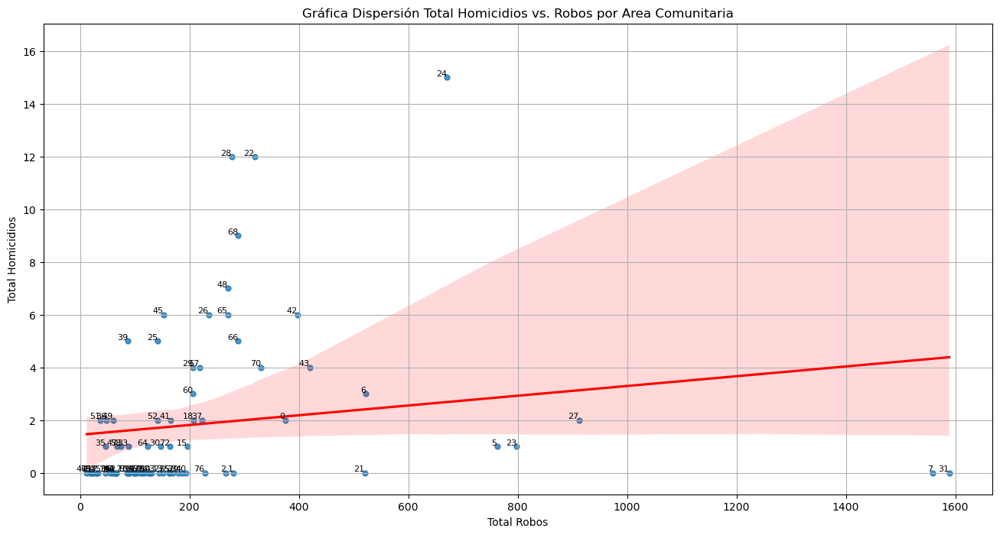

In [24]:
# Utilice este espacio para escribir el código.
# Plot scatter plot with regression line
plt.figure(figsize=(16, 8))
ax = sns.regplot(x='total_robos', y='total_homicidios', data=resumen.iloc[:-1], scatter_kws={'s':25}, line_kws={'color':'red'})

# Add annotations for each point
for i, row in resumen.iloc[:-1].iterrows():
    ax.text(row['total_robos'], row['total_homicidios'], str(i),
            fontsize=8, ha='right', va='bottom')

plt.title('Gráfica Dispersión Total Homicidios vs. Robos por Area Comunitaria')
plt.xlabel('Total Robos')
plt.ylabel('Total Homicidios')
plt.grid(True)
plt.show()

(Utilice este espacio para describir el procedimiento, análisis, y conclusiones)

### 3. Distribución espacial del delito

#### 3.1 Distribución respecto al centro de la ciudad

Tomando como centro de la ciudad las coordenadas (-87.627800, 41.881998), estime funciones de densidad que muestren gráficamente el gradiente del total de robos, y homicidios, como función de la distancia al centro de la ciudad. Explique cómo midió las distancias incluyendo que medida de distancia utilizó. Para elegir el ancho de banda y la función de kernel más apropiados utilice validación cruzada usando todas las opciones posibles de kernel. Describa los resultados que obtiene.

In [25]:
# Creamos las copias explícitamente para evitar el error
robos = delitos[delitos['tipo_crimen'] == 'robo'].copy()
homicidios = delitos[delitos['tipo_crimen'] == 'homicidio'].copy()

In [26]:
# Utilice este espacio para escribir el código.
from geopy.distance import geodesic
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KernelDensity

centro_ciudad = (41.881998, -87.627800)
# Función para calcular la distancia geodésica
def calcular_distancia(centro, coord):
    return geodesic(centro, coord).kilometers

robos.loc[:, 'distancia_centro'] = robos.apply(lambda row: calcular_distancia(centro_ciudad, (row['lat'], row['lon'])), axis=1)
homicidios.loc[:, 'distancia_centro'] = homicidios.apply(lambda row: calcular_distancia(centro_ciudad, (row['lat'], row['lon'])), axis=1)

In [27]:
robos

,fecha,tipo_crimen,nro_area_comunitaria,lat,lon,utc_time,fecha_hora_local,hora,dia,distancia_centro
144,2019-06-01T05:05:00Z,robo,38,41.808910,-87.616577,2019-06-01 05:05:00+00:00,2019-06-01 00:05:00-05:00,0,Saturday,8.171256
145,2019-06-01T05:30:00Z,robo,26,41.879814,-87.721559,2019-06-01 05:30:00+00:00,2019-06-01 00:30:00-05:00,0,Saturday,7.786236
146,2019-06-01T05:00:00Z,robo,3,41.969046,-87.658065,2019-06-01 05:00:00+00:00,2019-06-01 00:00:00-05:00,0,Saturday,9.989189
147,2019-06-01T05:02:00Z,robo,43,41.767848,-87.566499,2019-06-01 05:02:00+00:00,2019-06-01 00:02:00-05:00,0,Saturday,13.663260
148,2019-06-01T05:57:00Z,robo,45,41.743970,-87.585797,2019-06-01 05:57:00+00:00,2019-06-01 00:57:00-05:00,0,Saturday,15.722932
...,...,...,...,...,...,...,...,...,...,...
17742,2019-08-20T18:00:00Z,robo,77,41.980874,-87.659992,2019-08-20 18:00:00+00:00,2019-08-20 13:00:00-05:00,13,Tuesday,11.302257
17743,2019-06-20T17:00:00Z,robo,77,41.987182,-87.666804,2019-06-20 17:00:00+00:00,2019-06-20 12:00:00-05:00,12,Thursday,12.122510
17744,2019-08-01T05:01:00Z,robo,25,41.890446,-87.757887,2019-08-01 05:01:00+00:00,2019-08-01 00:01:00-05:00,0,Thursday,10.837667
17745,2019-08-19T05:01:00Z,robo,8,41.904537,-87.634504,2019-08-19 05:01:00+00:00,2019-08-19 00:01:00-05:00,0,Monday,2.564488


In [28]:
robos.describe()

,nro_area_comunitaria,lat,lon,hora,distancia_centro
count,17603.000000,17603.000000,17603.000000,17603.000000,17603.000000
mean,31.998921,41.863780,-87.665025,13.400045,8.997990
std,21.452122,0.081806,0.054912,6.180672,5.999846
min,1.000000,41.644608,-87.917645,0.000000,0.023621
25%,14.000000,41.796777,-87.696456,10.000000,3.850411
50%,28.000000,41.883500,-87.654795,14.000000,8.638871
75%,44.000000,41.917656,-87.627842,18.000000,13.384083
max,77.000000,42.022536,-87.525645,23.000000,27.285786


In [29]:
std_dist_robos = robos['distancia_centro'].std()
h_silverman_robos1 = 0.9*std_dist_robos*(len(robos)**-0.2)
h_silverman_robos1

0.7643024872769176

In [30]:
IQR_robos = robos['distancia_centro'].quantile(0.75) - robos['distancia_centro'].quantile(0.25)
print("IQR:", IQR_robos)
h_silverman_robos2 = 0.9*IQR_robos*(len(robos)**-0.2)
h_silverman_robos2

IQR: 9.533671979899985


1.214466044957562

In [31]:
# Definir un rango de valores de ancho de banda y tipos de kernels
param_grid_robos = {
    'bandwidth': np.linspace(h_silverman_robos1/2, h_silverman_robos1*1.5, 20),  # Ancho de banda alrededor de Silverman's
    'kernel': ['gaussian', 'tophat', 'epanechnikov', 'exponential', 'linear', 'cosine']
}

In [34]:
# GridSearchCV
# Función para ajustar KernelDensity con validación cruzada
def estimar_kde(distancias, param_grid):
    kde = KernelDensity()
    grid = GridSearchCV(kde, param_grid = param_grid, cv=5, n_jobs=-1)
    grid.fit(distancias[:, None])  # Ajustamos el modelo
    resultados_kde = pd.DataFrame(grid.cv_results_)
    return resultados_kde, grid.best_estimator_, grid.best_params_

In [35]:
# Estimar densidad para robos
resultados_kde_robos, kde_robos, best_params_robos = estimar_kde(robos['distancia_centro'].values, param_grid_robos)
print(f"Mejores parámetros para robos: {best_params_robos}")

Mejores parámetros para robos: {'bandwidth': 0.3821512436384588, 'kernel': 'linear'}


In [36]:
resultados_kde_robos.sort_values(by='rank_test_score')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_bandwidth,param_kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
4,0.002487,0.000101,0.123944,0.004689,0.382151,linear,"{'bandwidth': 0.3821512436384588, 'kernel': 'l...",-10667.380751,-10644.187318,-10722.743819,-10604.324568,-10850.882826,-10697.903856,85.549750,1
10,0.002857,0.000509,0.133594,0.007052,0.422378,linear,"{'bandwidth': 0.4223776903372439, 'kernel': 'l...",-10673.363384,-10651.090661,-10728.572891,-10606.429315,-10856.039103,-10703.099071,85.992670,2
16,0.002745,0.000296,0.143904,0.004121,0.462604,linear,"{'bandwidth': 0.4626041370360291, 'kernel': 'l...",-10679.705682,-10658.126588,-10734.288211,-10608.770351,-10861.019435,-10708.382053,86.301491,3
5,0.002633,0.000615,0.129812,0.004572,0.382151,cosine,"{'bandwidth': 0.3821512436384588, 'kernel': 'c...",-10679.181017,-10657.259637,-10734.978200,-10612.466720,-10861.129411,-10709.002997,85.677460,4
2,0.002725,0.000314,0.122796,0.003968,0.382151,epanechnikov,"{'bandwidth': 0.3821512436384588, 'kernel': 'e...",-10681.120003,-10659.624346,-10737.116875,-10613.145766,-10862.532282,-10710.707854,85.733797,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114,0.002764,0.000139,2.258321,0.016236,1.146454,gaussian,"{'bandwidth': 1.1464537309153764, 'kernel': 'g...",-10886.960804,-10876.451027,-10924.062463,-10857.716358,-11033.000078,-10915.638146,62.542379,116
99,0.002741,0.000121,2.304122,0.011357,1.025774,exponential,"{'bandwidth': 1.0257743908190209, 'kernel': 'e...",-10889.988365,-10879.185237,-10925.727817,-10861.969749,-11033.190642,-10918.012362,61.252313,117
105,0.002820,0.000219,2.280875,0.019026,1.066001,exponential,"{'bandwidth': 1.066000837517806, 'kernel': 'ex...",-10899.036321,-10888.234768,-10933.739965,-10873.404722,-11040.551878,-10926.993531,60.160818,118
111,0.002692,0.000104,2.295884,0.011700,1.106227,exponential,"{'bandwidth': 1.1062272842165912, 'kernel': 'e...",-10908.007045,-10897.185652,-10941.686453,-10884.663558,-11047.851243,-10935.878790,59.107618,119


In [37]:
homicidios.describe()

,nro_area_comunitaria,lat,lon,hora,distancia_centro
count,144.000000,144.000000,144.000000,144.000000,144.000000
mean,40.333333,41.818997,-87.667527,11.173611,11.458908
std,18.272606,0.072950,0.060895,7.612402,4.386565
min,1.000000,41.678039,-87.767925,0.000000,3.060514
25%,25.000000,41.757565,-87.717817,4.000000,7.933633
50%,38.000000,41.818880,-87.666231,12.500000,10.721770
75%,52.250000,41.884064,-87.623932,18.000000,14.331460
max,73.000000,42.018967,-87.529360,23.000000,22.659096


In [38]:
std_dist_homicidios = homicidios['distancia_centro'].std()
h_silverman_homicidios1 = 0.9*std_dist_homicidios*(len(homicidios)**-0.2)
h_silverman_homicidios1

1.4611492832950785

In [39]:
IQR_homicidios = homicidios['distancia_centro'].quantile(0.75) - homicidios['distancia_centro'].quantile(0.25)
print("IQR:", IQR_homicidios)
h_silverman_homicidios2 = 0.9*IQR_homicidios*(len(homicidios)**-0.2)
h_silverman_homicidios2

IQR: 6.397826908352563


2.1310934644013337

In [40]:
# Definir un rango de valores de ancho de banda y tipos de kernels
param_grid_homicidios = {
    'bandwidth': np.linspace(h_silverman_homicidios1/2, h_silverman_homicidios2*2, 20),  # Ancho de banda alrededor de Silverman's
    'kernel': ['gaussian', 'tophat', 'epanechnikov', 'exponential', 'linear', 'cosine']
}

In [41]:
# Estimar densidad para homicidios
resultados_kde_homicidios, kde_homicidios, best_params_homicidios = estimar_kde(homicidios['distancia_centro'].values, param_grid_homicidios)
print(f"Mejores parámetros para homicidios: {best_params_homicidios}")

Mejores parámetros para homicidios: {'bandwidth': 0.7305746416475393, 'kernel': 'exponential'}


In [42]:
resultados_kde_homicidios.sort_values(by='rank_test_score')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_bandwidth,param_kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
3,0.000166,0.000046,0.000189,0.000009,0.730575,exponential,"{'bandwidth': 0.7305746416475393, 'kernel': 'e...",-83.993593,-80.552449,-90.465349,-78.548013,-80.064893,-82.724859,4.260650,1
7,0.000178,0.000069,0.000232,0.000079,0.916449,tophat,"{'bandwidth': 0.9164489725504408, 'kernel': 't...",-84.717452,-80.768364,-89.994278,-78.510254,-79.790523,-82.756174,4.171596,2
9,0.000397,0.000498,0.000257,0.000125,0.916449,exponential,"{'bandwidth': 0.9164489725504408, 'kernel': 'e...",-83.774929,-80.495751,-90.677544,-78.969428,-80.188363,-82.821203,4.238099,3
28,0.000252,0.000198,0.000168,0.000077,1.474072,linear,"{'bandwidth': 1.4740719652591452, 'kernel': 'l...",-84.963388,-80.553582,-90.584372,-78.323578,-79.960332,-82.877050,4.436112,4
0,0.000145,0.000065,0.000182,0.000026,0.730575,gaussian,"{'bandwidth': 0.7305746416475393, 'kernel': 'g...",-84.657530,-80.286739,-90.875755,-78.511668,-80.072245,-82.880788,4.489600,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,0.000478,0.000533,0.000269,0.000072,3.51869,exponential,"{'bandwidth': 3.5186896051910614, 'kernel': 'e...",-86.494730,-85.095908,-91.503607,-84.850730,-84.139185,-86.416832,2.655806,116
99,0.000123,0.000021,0.000177,0.000006,3.704564,exponential,"{'bandwidth': 3.704563936093963, 'kernel': 'ex...",-86.871156,-85.529062,-91.700667,-85.303899,-84.496309,-86.780219,2.576053,117
105,0.000127,0.000015,0.000177,0.000005,3.890438,exponential,"{'bandwidth': 3.8904382669968647, 'kernel': 'e...",-87.254428,-85.964669,-91.913794,-85.757348,-84.858015,-87.149651,2.502092,118
111,0.000127,0.000009,0.000181,0.000005,4.076313,exponential,"{'bandwidth': 4.076312597899766, 'kernel': 'ex...",-87.643055,-86.401745,-92.141266,-86.210388,-85.223448,-87.523980,2.433553,119


In [43]:
robos['distancia_centro'].max()

27.28578609082597

In [44]:
homicidios['distancia_centro'].max()

22.65909622945349

In [45]:
# Generar los valores para la gráfica
distancia_range = np.linspace(0, 30, 500)

In [46]:
# Densidad para robos
log_dens_robos = kde_robos.score_samples(distancia_range[:, None])
densidad_robos = np.exp(log_dens_robos)

# Densidad para homicidios
log_dens_homicidios = kde_homicidios.score_samples(distancia_range[:, None])
densidad_homicidios = np.exp(log_dens_homicidios)

a. kde_robos.score_samples(distancia_range[:, None]):

	•	kde_robos: This is a trained Kernel Density Estimator for robberies.
    •	score_samples: This function computes the log of the density estimate at each point in distancia_range.
	•	log_dens_robos is the result, which contains the log density for each distance point.

b. np.exp(log_dens_robos):

	•	The output of score_samples is in logarithmic form (natural log). The np.exp() function is used to exponentiate the log density values, converting them back to regular density values.
	•	densidad_robos holds the estimated density (probability) values for robberies at each distance.

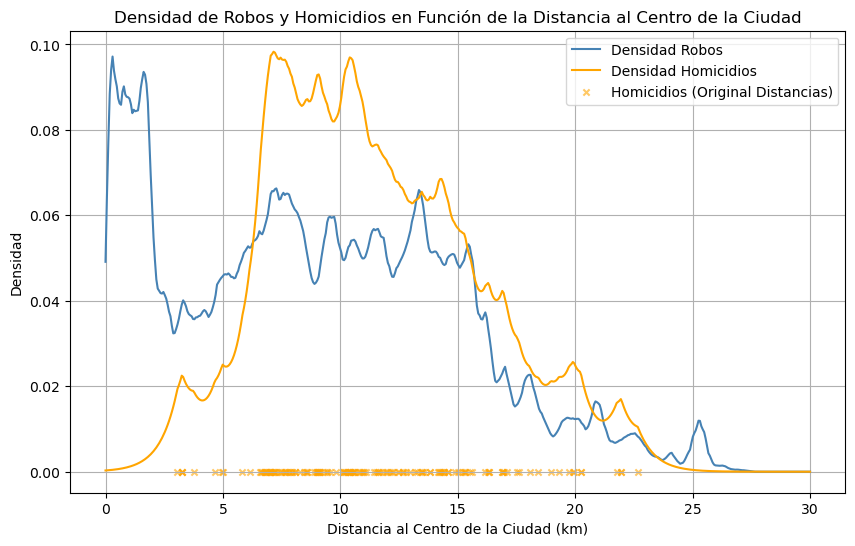

In [47]:
# Graficar las densidades
plt.figure(figsize=(10, 6))
plt.plot(distancia_range, densidad_robos, label='Densidad Robos', color='steelblue')
plt.plot(distancia_range, densidad_homicidios, label='Densidad Homicidios', color='orange')

# distancias robos
#plt.scatter(robos['distancia_centro'], np.zeros_like(robos['distancia_centro']), 
#            color='steelblue', alpha=0.6, s=20, label='Robos (Original Distancias)', marker='x')

# distancias homicidios
plt.scatter(homicidios['distancia_centro'], np.zeros_like(homicidios['distancia_centro']), 
            color='orange', alpha=0.6, s=20, label='Homicidios (Original Distancias)', marker='x')

plt.title('Densidad de Robos y Homicidios en Función de la Distancia al Centro de la Ciudad')
plt.xlabel('Distancia al Centro de la Ciudad (km)')
plt.ylabel('Densidad')
plt.legend()
plt.grid(True)
plt.show()

(Utilice este espacio para describir el procedimiento, análisis, y conclusiones)

### 3.2 Puntos calientes en la ciudad

Usando `statsmodels` implemente la estimación de densidad bivariada para el total de robos y el total de homicidios. Muestre los resultados usando curvas de nivel en una visualización interactiva. Compare los resultados de estimar usando los anchos de banda: `normal_reference` y `cv_ml`. Explique en que consisten ambas formas de estimar el ancho de banda. Comente sobre los puntos calientes encontrados bajo ambos métodos y su ubicación en la ciudad. (Esto puede tomar mucho tiempo y requerir mucha capacidad computacional, puede aprovechar los recursos de [Google Colab](https://colab.research.google.com/))

**OJO! Ver KDEMultivariate Documentation:** https://www.statsmodels.org/devel/generated/statsmodels.nonparametric.kernel_density.KDEMultivariate.html

In [48]:
# Utilice este espacio para escribir el código.
import statsmodels.api as sm

##### 3.2.1. Densidad de Robos - Normal Reference

In [49]:
dens_robos_nr = sm.nonparametric.KDEMultivariate(data=robos[["lat", "lon"]], var_type='cc', bw='normal_reference')
dens_robos_nr.bw

array([0.01700125, 0.01141213])

In [50]:
dens_homicidios_nr = sm.nonparametric.KDEMultivariate(data=homicidios[["lat", "lon"]], var_type='cc', bw='normal_reference')
dens_homicidios_nr.bw

array([0.03365809, 0.02809606])

In [51]:
print('longitud minima robos:', min(robos.lon))
print('longitud maxima robos:', max(robos.lon))
print('latitud minima robos:', min(robos.lat))
print('latitud maxima robos:', max(robos.lat))

longitud minima robos: -87.917644638
longitud maxima robos: -87.525645351
latitud minima robos: 41.644607723
latitud maxima robos: 42.02253638


In [52]:
print('longitud minima homicidios:', min(homicidios.lon))
print('longitud maxima homicidios:', max(homicidios.lon))
print('latitud minima homicidios:', min(homicidios.lat))
print('latitud maxima homicidios:', max(homicidios.lat))

longitud minima homicidios: -87.767924691
longitud maxima homicidios: -87.52935993
latitud minima homicidios: 41.678038746
latitud maxima homicidios: 42.018966968


In [53]:
# Grilla de valores dentro del rango observado (2 dimensiones)
x = np.linspace(min(robos.lon)-.01, max(robos.lon)+.01, 250)
y = np.linspace(min(robos.lat)-.01, max(robos.lat)+.01, 250)
xx, yy = np.meshgrid(x, y)
grid = np.column_stack((yy.flatten(),xx.flatten()))
grid

array([[ 41.63460772, -87.92764464],
       [ 41.63460772, -87.92599002],
       [ 41.63460772, -87.92433541],
       ...,
       [ 42.03253638, -87.51895458],
       [ 42.03253638, -87.51729997],
       [ 42.03253638, -87.51564535]])

In [54]:
# Predicciones robos nueva grilla
densidad_pred_robos_nr=dens_robos_nr.pdf(data_predict=grid)

##### Homicidios

In [55]:
## Predicciones homicidios nueva grilla
densidad_pred_homicidios_nr=dens_homicidios_nr.pdf(data_predict=grid)

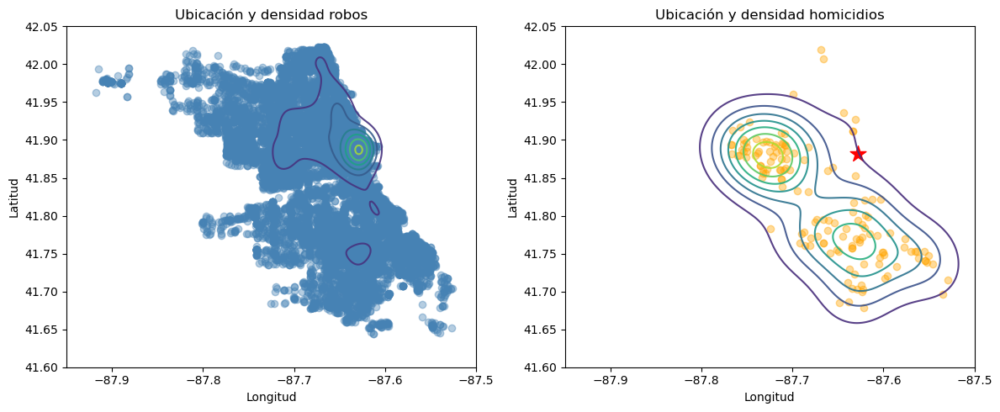

In [56]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

min_lon, max_lon = -87.95, -87.5  
min_lat, max_lat = 41.60, 42.05   

# Plot the center 
centro_ciudad = (-87.627800, 41.881998)

# Plot for Robberies
ax[0].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[0].scatter(robos.lon, robos.lat, color='steelblue', alpha=0.4)
ax[0].contour(
    xx, yy, densidad_pred_robos_nr.reshape(xx.shape),
    alpha=0.9
)
ax[0].set_title('Ubicación y densidad robos')
ax[0].set_xlabel('Longitud')
ax[0].set_ylabel('Latitud')
ax[0].set_xlim(min_lon, max_lon)  # Set longitude limits
ax[0].set_ylim(min_lat, max_lat)  # Set latitude limits

# Plot for Homicides
ax[1].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[1].scatter(homicidios.lon, homicidios.lat, color='orange', alpha=0.4)
ax[1].contour(
    xx, yy, densidad_pred_homicidios_nr.reshape(xx.shape),
    alpha=0.9
)
ax[1].set_title('Ubicación y densidad homicidios')
ax[1].set_xlabel('Longitud')
ax[1].set_ylabel('Latitud')
ax[1].set_xlim(min_lon, max_lon)  # Set longitude limits
ax[1].set_ylim(min_lat, max_lat)  # Set latitude limits

# Adjust layout
plt.tight_layout()
plt.show()

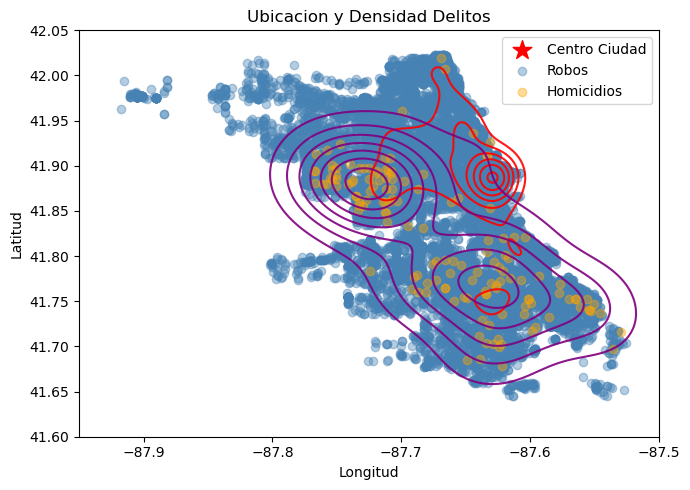

In [57]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 5))

ax.scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax.scatter(robos.lon, robos.lat, color='steelblue', alpha=0.4, label='Robos')
ax.contour(
    xx, yy, densidad_pred_robos_nr.reshape(xx.shape),
    alpha=0.9, colors='red'
)

ax.scatter(homicidios.lon, homicidios.lat, color='orange', alpha=0.4, label='Homicidios')
ax.contour(
    xx, yy, densidad_pred_homicidios_nr.reshape(xx.shape),
    alpha=0.9, colors='purple'
)

# Set axis limits
ax.set_xlim(min_lon, max_lon)  
ax.set_ylim(min_lat, max_lat)  

ax.set_title('Ubicacion y Densidad Delitos')
ax.set_xlabel('Longitud')
ax.set_ylabel('Latitud')
ax.legend()
plt.tight_layout()
plt.show()

##### 3.2.2. Densidad de Robos - CV_ML

In [58]:
# Utilice este espacio para escribir el código.
dens_robos_cm = sm.nonparametric.KDEMultivariate(data=robos[["lat", "lon"]], var_type='cc', bw='cv_ml')
dens_robos_cm.bw

/Users/alejandra/anaconda3/envs/MIAD_ANS/lib/python3.11/site-packages/statsmodels/nonparametric/kernel_density.py:158: RuntimeWarning: invalid value encountered in log
  L += func(f_i)
/Users/alejandra/anaconda3/envs/MIAD_ANS/lib/python3.11/site-packages/statsmodels/nonparametric/kernel_density.py:158: RuntimeWarning: divide by zero encountered in log
  L += func(f_i)


array([0.00013767, 0.00565121])

In [59]:
# cv_ls took forever!.
#dens_robos_cm = sm.nonparametric.KDEMultivariate(data=robos[["lat", "lon"]], var_type='cc', bw='cv_ls')
#dens_robos_cm.bw

In [60]:
dens_homicidios_cm = sm.nonparametric.KDEMultivariate(data=homicidios[["lat", "lon"]], var_type='cc', bw='cv_ml')
dens_homicidios_cm.bw

array([0.01405423, 0.01054009])

In [61]:
## nueva grilla 
densidad_pred_robos_cm=dens_robos_cm.pdf(data_predict=grid)

##### Homicidios

In [62]:
# nueva grilla
densidad_pred_homicidios_cm=dens_homicidios_cm.pdf(data_predict=grid)

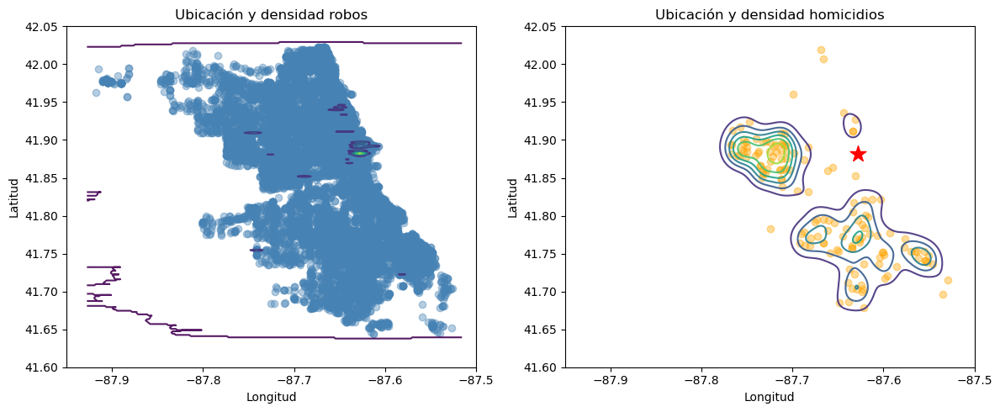

In [63]:
# Nueva grilla
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

min_lon, max_lon = -87.95, -87.5  
min_lat, max_lat = 41.60, 42.05   

# Plot the center 
centro_ciudad = (-87.627800, 41.881998)

ax[0].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[1].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')

# Robos
ax[0].scatter(robos.lon, robos.lat, color='steelblue', alpha=0.4)
ax[0].contour(
    xx, yy, densidad_pred_robos_cm.reshape(xx.shape),
    alpha=0.9
)
ax[0].set_title('Ubicación y densidad robos')
ax[0].set_xlabel('Longitud')
ax[0].set_ylabel('Latitud')
ax[0].set_xlim(min_lon, max_lon)  
ax[0].set_ylim(min_lat, max_lat)

# Homicidios
ax[1].scatter(homicidios.lon, homicidios.lat, color='orange', alpha=0.4)
ax[1].contour(
    xx, yy, densidad_pred_homicidios_cm.reshape(xx.shape),
    alpha=0.9
)
ax[1].set_title('Ubicación y densidad homicidios')
ax[1].set_xlabel('Longitud')
ax[1].set_ylabel('Latitud')
ax[1].set_xlim(min_lon, max_lon) 
ax[1].set_ylim(min_lat, max_lat)  

plt.tight_layout()
plt.show()

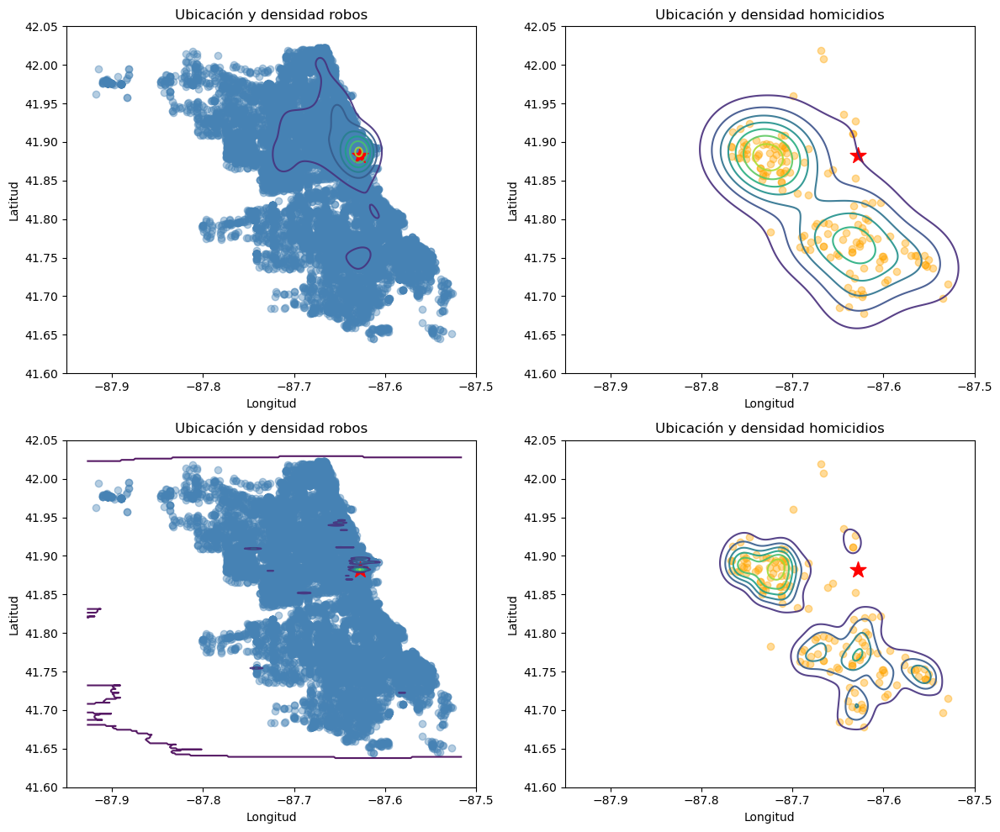

In [64]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(12,10))

min_lon, max_lon = -87.95, -87.5  
min_lat, max_lat = 41.60, 42.05   

# Plot the center 
centro_ciudad = (-87.627800, 41.881998)

# Robos_nr
ax[0,0].scatter(robos.lon, robos.lat, color='steelblue', alpha=0.4)
ax[0,0].contour(
    xx, yy, densidad_pred_robos_nr.reshape(xx.shape),
    alpha=0.9
)
ax[0,0].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[0,0].set_title('Ubicación y densidad robos')
ax[0,0].set_xlabel('Longitud')
ax[0,0].set_ylabel('Latitud')
ax[0,0].set_xlim(min_lon, max_lon)  
ax[0,0].set_ylim(min_lat, max_lat) 

# Homicidios_nr
ax[0,1].scatter(homicidios.lon, homicidios.lat, color='orange', alpha=0.4)
ax[0,1].contour(
    xx, yy, densidad_pred_homicidios_nr.reshape(xx.shape),
    alpha=0.9
)
ax[0,1].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[0,1].set_title('Ubicación y densidad homicidios')
ax[0,1].set_xlabel('Longitud')
ax[0,1].set_ylabel('Latitud')
ax[0,1].set_xlim(min_lon, max_lon)  
ax[0,1].set_ylim(min_lat, max_lat)  

# robos cv_ml
ax[1,0].scatter(robos.lon, robos.lat, color='steelblue', alpha=0.4)
ax[1,0].contour(
    xx, yy, densidad_pred_robos_cm.reshape(xx.shape),
    alpha=0.9
)
ax[1,0].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[1,0].set_title('Ubicación y densidad robos')
ax[1,0].set_xlabel('Longitud')
ax[1,0].set_ylabel('Latitud')
ax[1,0].set_xlim(min_lon, max_lon) 
ax[1,0].set_ylim(min_lat, max_lat)  

# Homicidios cv_ml
ax[1,1].scatter(homicidios.lon, homicidios.lat, color='orange', alpha=0.4)
ax[1,1].contour(
    xx, yy, densidad_pred_homicidios_cm.reshape(xx.shape),
    alpha=0.9
)
ax[1,1].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[1,1].set_title('Ubicación y densidad homicidios')
ax[1,1].set_xlabel('Longitud')
ax[1,1].set_ylabel('Latitud')
ax[1,1].set_xlim(min_lon, max_lon)  
ax[1,1].set_ylim(min_lat, max_lat)

# Adjust layout
plt.tight_layout()
plt.show()

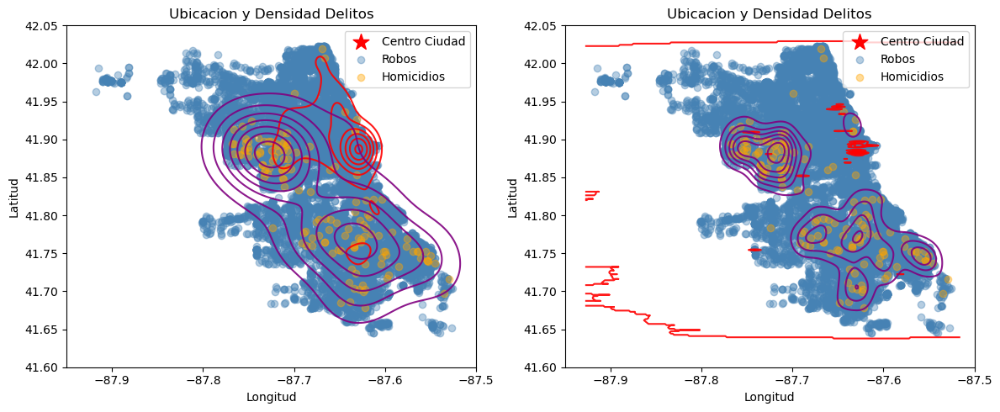

In [65]:
# nueva grilla
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

ax[0].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[0].scatter(robos.lon, robos.lat, color='steelblue', alpha=0.4, label='Robos')
ax[0].contour(
    xx, yy, densidad_pred_robos_nr.reshape(xx.shape),
    alpha=0.9, colors='red'
)

ax[0].scatter(homicidios.lon, homicidios.lat, color='orange', alpha=0.4, label='Homicidios')
ax[0].contour(
    xx, yy, densidad_pred_homicidios_nr.reshape(xx.shape),
    alpha=0.9, colors='purple'
)

ax[0].set_xlim(min_lon, max_lon)  
ax[0].set_ylim(min_lat, max_lat)  

ax[0].set_title('Ubicacion y Densidad Delitos')
ax[0].set_xlabel('Longitud')
ax[0].set_ylabel('Latitud')
ax[0].legend()


ax[1].scatter(centro_ciudad[0], centro_ciudad[1], color='red', s=200, marker='*', label='Centro Ciudad')
ax[1].scatter(robos.lon, robos.lat, color='steelblue', alpha=0.4, label='Robos')
ax[1].contour(
    xx, yy, densidad_pred_robos_cm.reshape(xx.shape),
    alpha=0.9, colors='red'
)

ax[1].scatter(homicidios.lon, homicidios.lat, color='orange', alpha=0.4, label='Homicidios')
ax[1].contour(
    xx, yy, densidad_pred_homicidios_cm.reshape(xx.shape),
    alpha=0.9, colors='purple'
)

ax[1].set_xlim(min_lon, max_lon)  
ax[1].set_ylim(min_lat, max_lat)  

ax[1].set_title('Ubicacion y Densidad Delitos')
ax[1].set_xlabel('Longitud')
ax[1].set_ylabel('Latitud')
ax[1].legend()

plt.tight_layout()
plt.show()

##### 3.2.3. Mapa Interactivo

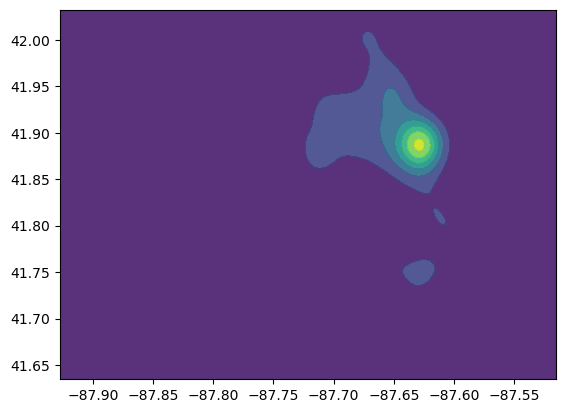

In [68]:
import geojsoncontour

contourf_robos = plt.contourf(xx, yy, densidad_pred_robos_nr.reshape(xx.shape),
    levels= 6, alpha =0.9, linestyles='None')
                        
geojson_robos = geojsoncontour.contourf_to_geojson(
    contourf=contourf_robos,
    min_angle_deg=3.0,
    ndigits=5,
    stroke_width=1,
    fill_opacity=0.1)

In [69]:
'''
# Create contour plot with only the levels (no background fill)
contour_robos = plt.contour(xx, yy, densidad_pred_robos_nr.reshape(xx.shape),
                                 levels=10,  # Number of contour levels (adjust as needed)
                                 colors='maroon',  # Specify contour line color
                                 linewidths=1.5)  # Line width for the contours

# Convert to GeoJSON
geojson_robos = geojsoncontour.contour_to_geojson(
    contour=contour_robos,
    min_angle_deg=3.0,
    ndigits=5,
    stroke_width=1
)

plt.show()
'''

"\n# Create contour plot with only the levels (no background fill)\ncontour_robos = plt.contour(xx, yy, densidad_pred_robos_nr.reshape(xx.shape),\n                                 levels=10,  # Number of contour levels (adjust as needed)\n                                 colors='maroon',  # Specify contour line color\n                                 linewidths=1.5)  # Line width for the contours\n\n# Convert to GeoJSON\ngeojson_robos = geojsoncontour.contour_to_geojson(\n    contour=contour_robos,\n    min_angle_deg=3.0,\n    ndigits=5,\n    stroke_width=1\n)\n\nplt.show()\n"

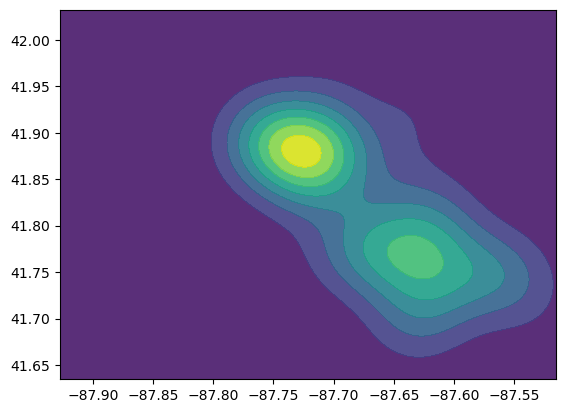

In [70]:
contourf_homicidios = plt.contourf(xx, yy, densidad_pred_homicidios_nr.reshape(xx.shape),
    alpha =0.9, linestyles='None')
                        
geojson_homicidios = geojsoncontour.contourf_to_geojson(
    contourf=contourf_homicidios,
    min_angle_deg=3.0,
    ndigits=5,
    stroke_width=1,
    fill_opacity=0.1)

In [71]:
'''
# Create contour plot with only the levels (no background fill)
contour_homicidios = plt.contour(xx, yy, densidad_pred_homicidios_nr.reshape(xx.shape),
                                 levels=10,  # Number of contour levels (adjust as needed)
                                 colors='red',  # Specify contour line color
                                 linewidths=1.5)  # Line width for the contours

# Convert to GeoJSON
geojson_homicidios = geojsoncontour.contour_to_geojson(
    contour=contour_homicidios,
    min_angle_deg=3.0,
    ndigits=5,
    stroke_width=1
)

plt.show()
'''

"\n# Create contour plot with only the levels (no background fill)\ncontour_homicidios = plt.contour(xx, yy, densidad_pred_homicidios_nr.reshape(xx.shape),\n                                 levels=10,  # Number of contour levels (adjust as needed)\n                                 colors='red',  # Specify contour line color\n                                 linewidths=1.5)  # Line width for the contours\n\n# Convert to GeoJSON\ngeojson_homicidios = geojsoncontour.contour_to_geojson(\n    contour=contour_homicidios,\n    min_angle_deg=3.0,\n    ndigits=5,\n    stroke_width=1\n)\n\nplt.show()\n"

In [72]:
#map = folium.Map([lst.latitude.mean(), lst.longitude.mean()], zoom_start=12, tiles="OpenStreetMap")# Plot the contour on Folium map
map = folium.Map(location = [41.881998, -87.627800], tiles = "OpenStreetMap", zoom_start = 10)

folium.GeoJson(
    geojson_robos,
    style_function=lambda x: {
        'color':     x['properties']['stroke'],
        'weight':    x['properties']['stroke-width'],
        'fillColor': '#FFFFFF',
        'lineColor': '#FFFFFF',
        'opacity':   0.5,
    }).add_to(map)

folium.GeoJson(
    geojson_homicidios,
    style_function=lambda x: {
        'color':     x['properties']['stroke'],
        'weight':    x['properties']['stroke-width'],
        'fillColor': '#FFFFFF',
        'lineColor': '#FFFFFF',
        'opacity':   0.5,
    }).add_to(map)

map

In [73]:
import folium

# Crear el mapa centrado en las coordenadas dadas
mapa = folium.Map(location=[41.881998, -87.627800], tiles="OpenStreetMap", zoom_start=10)

# Agregar GeoJson de robos
folium.GeoJson(
    geojson_robos,
    style_function=lambda x: {
        'color': x['properties'].get('stroke', '#FF0000'),  # Valor por defecto si no existe 'stroke'
        'weight': x['properties'].get('stroke-width', 2),   # Valor por defecto si no existe 'stroke-width'
        #'fillColor': '#FFFFFF',  # Color de relleno blanco
        #'fillOpacity': 0.5,      # Opacidad del relleno
        #'opacity': 0.5           # Opacidad del contorno
    }
).add_to(mapa)

# Agregar GeoJson de homicidios
folium.GeoJson(
    geojson_homicidios,
    style_function=lambda x: {
        'color': x['properties'].get('stroke', '#FF0000'),  # Valor por defecto si no existe 'stroke'
        'weight': x['properties'].get('stroke-width', 2),   # Valor por defecto si no existe 'stroke-width'
        #'fillColor': '#FFFFFF',  # Color de relleno blanco
        #'fillOpacity': 0.5,      # Opacidad del relleno
        #'opacity': 0.5           # Opacidad del contorno
    }
).add_to(mapa)

# Mostrar el mapa
mapa

(Utilice este espacio para describir el procedimiento, análisis, y conclusiones)

## 4. Explicando la ubicación del delito

El objetivo de este punto es encontrar posibles correlaciones  entre el crimen y características de la ciudad. Para ello, utilice los datos de OpenStreetMap y explore si existe una correlación entre el porcentaje del área de la comunidad  dedicado a tiendas (`retail`)  y comercios (`commercial`) y el número total de robos y homicidios en esa comunidad. Ofrezca una explicación intuitiva de por qué cree que aparecen estas correlaciones. (Esto puede tomar mucho tiempo y requerir mucha capacidad computacional, puede aprovechar los recursos de [Google Colab](https://colab.research.google.com/))

In [74]:
# Utilice este espacio para escribir el código.
from pyrosm import OSM, get_data

# Bajamos los datos para  Chicago
fp = get_data("Chicago")

# Inicializamos el lector para Chicago 
osm = OSM(fp)

In [75]:
custom_filter = {
    "shop": ["retail"],
    "landuse": ["commercial"]
}

# Extraemos los POIs que cumplen con el filtro
pois = osm.get_pois(custom_filter=custom_filter)

In [76]:
print(f"Número de puntos de interés 'retail' y 'commercial': {len(pois)}")

Número de puntos de interés 'retail' y 'commercial': 1365


In [77]:
pois.head()

,version,tags,lat,id,lon,visible,changeset,timestamp,addr:city,addr:housenumber,...,name,shop,landuse,geometry,osm_type,addr:country,operator,phone,website,construction
0,0,"{""addr:street:name"":""Chicago"",""addr:street:typ...",42.045128,2295225153,-87.679893,False,0.0,0,Evanston,1501A,...,Kier of Home,retail,None,POINT (-87.67989 42.04513),node,NaN,NaN,NaN,NaN,NaN
1,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189760,-87.624908,False,0.0,0,Chicago,316,...,Ragan Communication,None,commercial,POINT (-87.62491 41.88729),node,NaN,NaN,NaN,NaN,NaN
2,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189761,-87.624977,False,0.0,0,Chicago,316,...,emw,None,commercial,POINT (-87.62498 41.88729),node,NaN,NaN,NaN,NaN,NaN
3,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189762,-87.625046,False,0.0,0,Chicago,316,...,"Urban Real Estate Research, Inc.",None,commercial,POINT (-87.62505 41.88729),node,NaN,NaN,NaN,NaN,NaN
4,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189763,-87.625122,False,0.0,0,Chicago,316,...,NueStep,None,commercial,POINT (-87.62512 41.88729),node,NaN,NaN,NaN,NaN,NaN


In [78]:
pois.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1365 entries, 0 to 1364
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   version           1365 non-null   int32   
 1   tags              193 non-null    object  
 2   lat               5 non-null      float32 
 3   id                1365 non-null   int64   
 4   lon               5 non-null      float32 
 5   visible           1339 non-null   object  
 6   changeset         31 non-null     float64 
 7   timestamp         1365 non-null   uint32  
 8   addr:city         12 non-null     object  
 9   addr:housenumber  12 non-null     object  
 10  addr:housename    2 non-null      object  
 11  addr:postcode     12 non-null     object  
 12  addr:street       12 non-null     object  
 13  name              43 non-null     object  
 14  shop              2 non-null      object  
 15  landuse           1364 non-null   object  
 16  geometry        

In [79]:
pois['addr:city'].unique()

array(['Evanston', 'Chicago', None, 'La Grange', 'Mount Prospect',
       'Des Plaines'], dtype=object)

In [80]:
pois['addr:city'].unique()

array(['Evanston', 'Chicago', None, 'La Grange', 'Mount Prospect',
       'Des Plaines'], dtype=object)

In [81]:
pois['tags'].unique()

array(['{"addr:street:name":"Chicago","addr:street:type":"Avenue"}',
       '{"addr:state":"IL","office":"yes"}', None, '{"source":"Yahoo"}',
       '{"source":"Bing"}', '{"source":"bing"}',
       '{"source":"www.zellerrealty.com/old-orchard-towers"}',
       '{"source":"http://www.loopnet.com/Listing/18138361/5440-N-Cumberland-Ave-Chicago-IL/"}',
       '{"note":"Natural Soaps and Cosmetics 61st Street Farmers\' Market"}',
       '{"note":"Bicycle Repair and Resale 61st Street Farmers\' Market"}',
       '{"maxspeed":"30 mph"}',
       '{"addr:state":"IL","amenity":"studio","studio":"video","wikidata":"Q1092360","wikipedia":"en:Cinespace Film Studios"}',
       '{"access":"permissive","addr:state":"IL"}',
       '{"addr:state":"IL","amenity":"parking","atm":"yes","drive_through":"yes"}',
       '{"wikidata":"Q5999368","wikipedia":"en:Illinois Center"}',
       '{"addr:state":"IL"}', '{"healthcare":"yes"}',
       '{"source":"local knowledge;aerial imagery;Zoning Map"}',
       '{"fix

In [82]:
pois[pois['shop']=='mall']

,version,tags,lat,id,lon,visible,changeset,timestamp,addr:city,addr:housenumber,...,name,shop,landuse,geometry,osm_type,addr:country,operator,phone,website,construction
1009,0,None,NaN,1098106359,NaN,False,NaN,0,None,None,...,Burr Ridge Village Center,mall,commercial,"POLYGON ((-87.91428 41.75497, -87.91238 41.755...",way,None,None,None,None,NaN


In [83]:
pois['landuse'].unique()

array([None, 'commercial'], dtype=object)

In [84]:
pois_chicago = pois[pois['addr:city'].isin(['Chicago', None])]
print(f"Número de POIs en la ciudad de Chicago: {len(pois_chicago)}")

Número de POIs en la ciudad de Chicago: 1361


In [85]:
#Mapa base
chicago_map = folium.Map(location = [41.881998, -87.627800], tiles = "OpenStreetMap", zoom_start = 10)

#capa areas
for _, row in areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(row['community'])
    ).add_to(chicago_map)

#capa retail and commercial
for _, row in pois.iterrows():
    folium.GeoJson(
        row['geometry'],
        #popup=folium.Popup(row['id'])
    ).add_to(chicago_map)

#Display el mapa
chicago_map

In [86]:
pois.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [87]:
areas.crs

<Geographic 2D CRS: GEOGCS["WGS84(DD)",DATUM["WGS84",SPHEROID["WGS84", ...>
Name: WGS84(DD)
Axis Info [ellipsoidal]:
- lon[east]: Longitude (degree)
- lat[north]: Latitude (degree)
Area of Use:
- undefined
Datum: WGS84
- Ellipsoid: WGS84
- Prime Meridian: Greenwich

In [88]:
if pois.crs != areas.crs:
    # Reproject 'pois' to match 'areas' CRS
    pois = pois.to_crs(areas.crs)

pois_within_areas = gpd.sjoin(pois, areas, predicate='within')
pois_within_areas.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 572 entries, 1 to 1364
Data columns (total 33 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   version           572 non-null    int32   
 1   tags              53 non-null     object  
 2   lat               4 non-null      float32 
 3   id                572 non-null    int64   
 4   lon               4 non-null      float32 
 5   visible           553 non-null    object  
 6   changeset         23 non-null     float64 
 7   timestamp         572 non-null    uint32  
 8   addr:city         7 non-null      object  
 9   addr:housenumber  7 non-null      object  
 10  addr:housename    2 non-null      object  
 11  addr:postcode     7 non-null      object  
 12  addr:street       7 non-null      object  
 13  name              21 non-null     object  
 14  shop              0 non-null      object  
 15  landuse           572 non-null    object  
 16  geometry          572 

In [89]:
# Create base map
chicago_map = folium.Map(location=[41.881998, -87.627800], tiles="OpenStreetMap", zoom_start=10)

# Add areas to the map
for _, row in areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(row['community'])
    ).add_to(chicago_map)

# Add retail and commercial POIs that are within areas
for _, row in pois_within_areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        # popup=folium.Popup(row['id'])  # Uncomment if you want to display the ID
    ).add_to(chicago_map)

# Display the map
chicago_map

In [90]:
# Create base map
chicago_map = folium.Map(location=[41.881998, -87.627800], tiles="OpenStreetMap", zoom_start=10)

# Add areas to the map
for _, row in areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(row['community']),
        style_function=lambda x: {'color': 'steelblue'}  # Style for areas
    ).add_to(chicago_map)

# Add retail and commercial POIs that are within areas
for _, row in pois_within_areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        style_function=lambda x: {'fillColor': 'green', 'color': 'green'}  # Style for POIs
        # popup=folium.Popup(row['id'])  # Uncomment if you want to display the ID
    ).add_to(chicago_map)

# densidad robos
folium.GeoJson(
    geojson_robos,
    style_function=lambda x: {
        'color':     x['properties']['stroke'],
        'weight':    x['properties']['stroke-width'],
        'fillColor': '#FFFFFF',
        'lineColor': '#FFFFFF',
        'opacity':   0.5,
    }).add_to(chicago_map)

# densidad homicidios
folium.GeoJson(
    geojson_homicidios,
    style_function=lambda x: {
        'color':     x['properties']['stroke'],
        'weight':    x['properties']['stroke-width'],
        'fillColor': '#FFFFFF',
        'lineColor': '#FFFFFF',
        'opacity':   0.5,
    }).add_to(chicago_map)   
    
# Display the map
chicago_map

In [91]:
pois_within_areas.head()

,version,tags,lat,id,lon,visible,changeset,timestamp,addr:city,addr:housenumber,...,index_right,area,area_num_1,area_numbe,comarea,comarea_id,community,perimeter,shape_area,shape_len
1,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189760,-87.624908,False,0.0,0,Chicago,316,...,37,0.0,32,32,0.0,0.0,LOOP,0.0,4.633557e+07,39428.672996
2,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189761,-87.624977,False,0.0,0,Chicago,316,...,37,0.0,32,32,0.0,0.0,LOOP,0.0,4.633557e+07,39428.672996
3,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189762,-87.625046,False,0.0,0,Chicago,316,...,37,0.0,32,32,0.0,0.0,LOOP,0.0,4.633557e+07,39428.672996
4,0,"{""addr:state"":""IL"",""office"":""yes""}",41.887287,2819189763,-87.625122,False,0.0,0,Chicago,316,...,37,0.0,32,32,0.0,0.0,LOOP,0.0,4.633557e+07,39428.672996
5,0,None,NaN,24822884,NaN,False,NaN,0,None,None,...,11,0.0,12,12,0.0,0.0,FOREST GLEN,0.0,8.913089e+07,74493.821604


In [92]:
pois_within_areas.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 572 entries, 1 to 1364
Data columns (total 33 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   version           572 non-null    int32   
 1   tags              53 non-null     object  
 2   lat               4 non-null      float32 
 3   id                572 non-null    int64   
 4   lon               4 non-null      float32 
 5   visible           553 non-null    object  
 6   changeset         23 non-null     float64 
 7   timestamp         572 non-null    uint32  
 8   addr:city         7 non-null      object  
 9   addr:housenumber  7 non-null      object  
 10  addr:housename    2 non-null      object  
 11  addr:postcode     7 non-null      object  
 12  addr:street       7 non-null      object  
 13  name              21 non-null     object  
 14  shop              0 non-null      object  
 15  landuse           572 non-null    object  
 16  geometry          572 

In [93]:
pois_within_areas['shop'].unique()

array([None, nan], dtype=object)

In [94]:
### BORRAR area in degrees
import folium
from shapely.geometry import shape  # Importing shapely to work with geometries

# Create base map
chicago_map = folium.Map(location=[41.881998, -87.627800], tiles="OpenStreetMap", zoom_start=10)

# Add areas to the map
for _, row in areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(row['community'])
    ).add_to(chicago_map)

# Add retail and commercial POIs that are within areas, and calculate their area
for _, row in pois_within_areas.iterrows():
    # Convert to Shapely geometry if it's not already
    poi_geometry = shape(row['geometry'])
    
    # Calculate the area of the POI (in degrees, as this depends on the CRS)
    poi_area = poi_geometry.area
    
    # Add to the map with a popup showing the area
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(f"Area: {poi_area:.2f} square degrees")  # Customize this as needed
    ).add_to(chicago_map)

# Display the map
chicago_map

In [95]:
# Calculo area mts cuadrados de las areas:

# Set the CRS of the original areas data to WGS84 (EPSG:4326) 
areas = gpd.GeoDataFrame(areas, geometry='geometry', crs="EPSG:4326")

# Reproject the geometries to UTM Zone 16N (EPSG:32616) for area calculation in meters
areas = areas.to_crs(epsg=32616)

# Calculate the area in square meters for each area
areas['area_sqm'] = areas['geometry'].area

In [96]:
# Calculo area mts cuadrados de los puntos de interes
# Set the CRS of the original data to WGS84 (EPSG:4326) if not already set
pois_within_areas = gpd.GeoDataFrame(pois_within_areas, geometry='geometry', crs="EPSG:4326")

# Reproject the geometries to UTM Zone 16N (EPSG:32616), which uses meters
pois_within_areas = pois_within_areas.to_crs(epsg=32616)

# Calculate the area in square meters for each POI
pois_within_areas['poi_area'] = pois_within_areas['geometry'].area

In [97]:
# Reproject back to EPSG:4326 for Folium
areas = areas.to_crs(epsg=4326)

pois_within_areas = pois_within_areas.to_crs(epsg=4326)

# Create a base map and add the reprojected geometries and areas
chicago_map = folium.Map(location=[41.881998, -87.627800], tiles="OpenStreetMap", zoom_start=10)

for _, row in areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(f"Community: {row['community']}, Area: {row['area_sqm']:.2f} m²")
    ).add_to(chicago_map)

# Optionally add POIs with their areas, as done previously
for _, row in pois_within_areas.iterrows():
    folium.GeoJson(
        row['geometry'],
        popup=folium.Popup(f"POI Area: {row['poi_area']:.2f} m²")
    ).add_to(chicago_map)

# Display the map
chicago_map

(Utilice este espacio para describir el procedimiento, análisis, y conclusiones)

In [98]:
areas['area_sqm']

0     4.270689e+06
1     1.570141e+06
2     1.848914e+06
3     4.501641e+06
4     2.698753e+06
          ...     
72    7.016921e+06
73    8.529327e+06
74    3.452242e+07
75    4.497788e+06
76    2.937112e+06
Name: area_sqm, Length: 77, dtype: float64

In [99]:
pois_within_areas['poi_area']

1            0.000000
2            0.000000
3            0.000000
4            0.000000
5        14306.828595
            ...      
1357      9311.584093
1358      3705.622447
1359      4442.900621
1363    354852.995001
1364    154911.384038
Name: poi_area, Length: 572, dtype: float64

In [100]:
pois_within_areas.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 572 entries, 1 to 1364
Data columns (total 34 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   version           572 non-null    int32   
 1   tags              53 non-null     object  
 2   lat               4 non-null      float32 
 3   id                572 non-null    int64   
 4   lon               4 non-null      float32 
 5   visible           553 non-null    object  
 6   changeset         23 non-null     float64 
 7   timestamp         572 non-null    uint32  
 8   addr:city         7 non-null      object  
 9   addr:housenumber  7 non-null      object  
 10  addr:housename    2 non-null      object  
 11  addr:postcode     7 non-null      object  
 12  addr:street       7 non-null      object  
 13  name              21 non-null     object  
 14  shop              0 non-null      object  
 15  landuse           572 non-null    object  
 16  geometry          572 

In [101]:
columns_to_keep = ['id', 'shop', 'landuse', 'area_numbe', 'community', 'geometry', 'poi_area']
pois_red = pois_within_areas[columns_to_keep].copy()
pois_red.head()

,id,shop,landuse,area_numbe,community,geometry,poi_area
1,2819189760,None,commercial,32,LOOP,POINT (-87.62491 41.88729),0.000000
2,2819189761,None,commercial,32,LOOP,POINT (-87.62498 41.88729),0.000000
3,2819189762,None,commercial,32,LOOP,POINT (-87.62505 41.88729),0.000000
4,2819189763,None,commercial,32,LOOP,POINT (-87.62512 41.88729),0.000000
5,24822884,None,commercial,12,FOREST GLEN,"POLYGON ((-87.77352 42.01186, -87.77352 42.011...",14306.828595


In [102]:
# if geometry = point => poi_area = 25 mts cuadrados
point_default_area = 25

# Replace 0s in 'poi_area' with 'point_default_area'
pois_red['poi_area'] = pois_red['poi_area'].replace(0, point_default_area)

In [103]:
pois_red.head()

,id,shop,landuse,area_numbe,community,geometry,poi_area
1,2819189760,None,commercial,32,LOOP,POINT (-87.62491 41.88729),25.000000
2,2819189761,None,commercial,32,LOOP,POINT (-87.62498 41.88729),25.000000
3,2819189762,None,commercial,32,LOOP,POINT (-87.62505 41.88729),25.000000
4,2819189763,None,commercial,32,LOOP,POINT (-87.62512 41.88729),25.000000
5,24822884,None,commercial,12,FOREST GLEN,"POLYGON ((-87.77352 42.01186, -87.77352 42.011...",14306.828595


In [104]:
# Utilice este espacio para escribir el código.
resumen_pois = pois_red.groupby('area_numbe').agg({
    'poi_area': 'sum',
    'community': 'first'  
}).reset_index()

In [105]:
resumen_pois

,area_numbe,poi_area,community
0,10,3.317664e+04,NORWOOD PARK
1,11,4.486487e+03,JEFFERSON PARK
2,12,4.798249e+04,FOREST GLEN
3,14,1.984234e+04,ALBANY PARK
4,16,1.363163e+03,IRVING PARK
5,17,4.159604e+04,DUNNING
6,19,4.412014e+04,BELMONT CRAGIN
7,2,8.361171e+03,WEST RIDGE
8,20,1.224023e+04,HERMOSA
9,21,1.803986e+04,AVONDALE


In [106]:
areas.head()

,area,area_num_1,area_numbe,comarea,comarea_id,community,perimeter,shape_area,shape_len,geometry,area_sqm
0,0.0,35,35,0.0,0.0,DOUGLAS,0.0,4.600462e+07,31027.054510,"POLYGON ((-87.60914 41.84469, -87.60915 41.844...",4.270689e+06
1,0.0,36,36,0.0,0.0,OAKLAND,0.0,1.691396e+07,19565.506153,"POLYGON ((-87.59215 41.81693, -87.59231 41.816...",1.570141e+06
2,0.0,37,37,0.0,0.0,FULLER PARK,0.0,1.991670e+07,25339.089750,"POLYGON ((-87.6288 41.80189, -87.62879 41.8017...",1.848914e+06
3,0.0,38,38,0.0,0.0,GRAND BOULEVARD,0.0,4.849250e+07,28196.837157,"POLYGON ((-87.60671 41.81681, -87.6067 41.8165...",4.501641e+06
4,0.0,39,39,0.0,0.0,KENWOOD,0.0,2.907174e+07,23325.167906,"POLYGON ((-87.59215 41.81693, -87.59215 41.816...",2.698753e+06


In [107]:
len(areas)

77

In [142]:
merged_areas = areas.merge(resumen_pois, on='area_numbe', how='left')

# Fill NaN values in 'poi_area' with 0
merged_areas['poi_area'] = merged_areas['poi_area'].fillna(0)

In [143]:
merged_areas

,area,area_num_1,area_numbe,comarea,comarea_id,community_x,perimeter,shape_area,shape_len,geometry,area_sqm,poi_area,community_y
0,0.0,35,35,0.0,0.0,DOUGLAS,0.0,4.600462e+07,31027.054510,"POLYGON ((-87.60914 41.84469, -87.60915 41.844...",4.270689e+06,1.157144e+05,DOUGLAS
1,0.0,36,36,0.0,0.0,OAKLAND,0.0,1.691396e+07,19565.506153,"POLYGON ((-87.59215 41.81693, -87.59231 41.816...",1.570141e+06,0.000000e+00,NaN
2,0.0,37,37,0.0,0.0,FULLER PARK,0.0,1.991670e+07,25339.089750,"POLYGON ((-87.6288 41.80189, -87.62879 41.8017...",1.848914e+06,0.000000e+00,NaN
3,0.0,38,38,0.0,0.0,GRAND BOULEVARD,0.0,4.849250e+07,28196.837157,"POLYGON ((-87.60671 41.81681, -87.6067 41.8165...",4.501641e+06,6.893950e+04,GRAND BOULEVARD
4,0.0,39,39,0.0,0.0,KENWOOD,0.0,2.907174e+07,23325.167906,"POLYGON ((-87.59215 41.81693, -87.59215 41.816...",2.698753e+06,3.041110e+04,KENWOOD
...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,0.0,74,74,0.0,0.0,MOUNT GREENWOOD,0.0,7.558429e+07,48665.130539,"POLYGON ((-87.69646 41.70714, -87.69644 41.706...",7.016921e+06,0.000000e+00,NaN
73,0.0,75,75,0.0,0.0,MORGAN PARK,0.0,9.187734e+07,46396.419362,"POLYGON ((-87.64215 41.68508, -87.64249 41.685...",8.529327e+06,6.970597e+03,MORGAN PARK
74,0.0,76,76,0.0,0.0,OHARE,0.0,3.718356e+08,173625.984660,"MULTIPOLYGON (((-87.83658 41.9864, -87.83658 4...",3.452242e+07,1.265380e+06,OHARE
75,0.0,77,77,0.0,0.0,EDGEWATER,0.0,4.844999e+07,31004.830946,"POLYGON ((-87.65456 41.99817, -87.65456 41.998...",4.497788e+06,1.848568e+03,EDGEWATER


In [144]:
resumen.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78 entries, 0 to 77
Data columns (total 6 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   nro_area_comunitaria   78 non-null     object 
 1   total_robos            78 non-null     int64  
 2   total_homicidios       78 non-null     int64  
 3   total_delitos          78 non-null     int64  
 4   porcentaje_robos       78 non-null     float64
 5   porcentaje_homicidios  78 non-null     float64
dtypes: float64(2), int64(3), object(1)
memory usage: 3.8+ KB


In [145]:
resumen2 = resumen[:-1].copy()

In [146]:
resumen2.tail()

,nro_area_comunitaria,total_robos,total_homicidios,total_delitos,porcentaje_robos,porcentaje_homicidios
72,73,164,1,165,0.924100,0.005635
73,74,21,0,21,0.118330,0.000000
74,75,124,0,124,0.698710,0.000000
75,76,163,0,163,0.918465,0.000000
76,77,228,0,228,1.284724,0.000000


In [147]:
resumen2.rename(columns={'nro_area_comunitaria': 'area_numbe'}, inplace=True)

In [148]:
resumen2['area_numbe'] = resumen2['area_numbe'].astype(int)

In [149]:
merged_areas['area_numbe'] = merged_areas['area_numbe'].astype(int)

In [160]:
merged_areas = merged_areas.merge(resumen2, on='area_numbe', how='left')

In [161]:
merged_areas.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 77 entries, 0 to 76
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   area                   77 non-null     float64 
 1   area_num_1             77 non-null     object  
 2   area_numbe             77 non-null     int64   
 3   comarea                77 non-null     float64 
 4   comarea_id             77 non-null     float64 
 5   community_x            77 non-null     object  
 6   perimeter              77 non-null     float64 
 7   shape_area             77 non-null     float64 
 8   shape_len              77 non-null     float64 
 9   geometry               77 non-null     geometry
 10  area_sqm               77 non-null     float64 
 11  poi_area               77 non-null     float64 
 12  community_y            52 non-null     object  
 13  total_robos            77 non-null     int64   
 14  total_homicidios       77 non-null  

In [162]:
merged_areas.head()

,area,area_num_1,area_numbe,comarea,comarea_id,community_x,perimeter,shape_area,shape_len,geometry,area_sqm,poi_area,community_y,total_robos,total_homicidios,total_delitos,porcentaje_robos,porcentaje_homicidios
0,0.0,35,35,0.0,0.0,DOUGLAS,0.0,4.600462e+07,31027.054510,"POLYGON ((-87.60914 41.84469, -87.60915 41.844...",4.270689e+06,115714.397608,DOUGLAS,186,0,186,1.048064,0.000000
1,0.0,36,36,0.0,0.0,OAKLAND,0.0,1.691396e+07,19565.506153,"POLYGON ((-87.59215 41.81693, -87.59231 41.816...",1.570141e+06,0.000000,NaN,47,1,48,0.264833,0.005635
2,0.0,37,37,0.0,0.0,FULLER PARK,0.0,1.991670e+07,25339.089750,"POLYGON ((-87.6288 41.80189, -87.62879 41.8017...",1.848914e+06,0.000000,NaN,48,2,50,0.270468,0.011270
3,0.0,38,38,0.0,0.0,GRAND BOULEVARD,0.0,4.849250e+07,28196.837157,"POLYGON ((-87.60671 41.81681, -87.6067 41.8165...",4.501641e+06,68939.497115,GRAND BOULEVARD,223,2,225,1.256550,0.011270
4,0.0,39,39,0.0,0.0,KENWOOD,0.0,2.907174e+07,23325.167906,"POLYGON ((-87.59215 41.81693, -87.59215 41.816...",2.698753e+06,30411.103391,KENWOOD,116,0,116,0.653632,0.000000


In [163]:
merged_areas['poi_area_sobre_area_sqm'] = merged_areas['poi_area'] / merged_areas['area_sqm'] 

In [164]:
merged_areas.head()

,area,area_num_1,area_numbe,comarea,comarea_id,community_x,perimeter,shape_area,shape_len,geometry,area_sqm,poi_area,community_y,total_robos,total_homicidios,total_delitos,porcentaje_robos,porcentaje_homicidios,poi_area_sobre_area_sqm
0,0.0,35,35,0.0,0.0,DOUGLAS,0.0,4.600462e+07,31027.054510,"POLYGON ((-87.60914 41.84469, -87.60915 41.844...",4.270689e+06,115714.397608,DOUGLAS,186,0,186,1.048064,0.000000,0.027095
1,0.0,36,36,0.0,0.0,OAKLAND,0.0,1.691396e+07,19565.506153,"POLYGON ((-87.59215 41.81693, -87.59231 41.816...",1.570141e+06,0.000000,NaN,47,1,48,0.264833,0.005635,0.000000
2,0.0,37,37,0.0,0.0,FULLER PARK,0.0,1.991670e+07,25339.089750,"POLYGON ((-87.6288 41.80189, -87.62879 41.8017...",1.848914e+06,0.000000,NaN,48,2,50,0.270468,0.011270,0.000000
3,0.0,38,38,0.0,0.0,GRAND BOULEVARD,0.0,4.849250e+07,28196.837157,"POLYGON ((-87.60671 41.81681, -87.6067 41.8165...",4.501641e+06,68939.497115,GRAND BOULEVARD,223,2,225,1.256550,0.011270,0.015314
4,0.0,39,39,0.0,0.0,KENWOOD,0.0,2.907174e+07,23325.167906,"POLYGON ((-87.59215 41.81693, -87.59215 41.816...",2.698753e+06,30411.103391,KENWOOD,116,0,116,0.653632,0.000000,0.011269


In [165]:
correlation = merged_areas[['porcentaje_robos', 'porcentaje_homicidios', 'poi_area_sobre_area_sqm']].corr()

                         porcentaje_robos  porcentaje_homicidios  \
porcentaje_robos                 1.000000               0.171123   
porcentaje_homicidios            0.171123               1.000000   
poi_area_sobre_area_sqm          0.654289              -0.091943   

                         poi_area_sobre_area_sqm  
porcentaje_robos                        0.654289  
porcentaje_homicidios                  -0.091943  
poi_area_sobre_area_sqm                 1.000000  


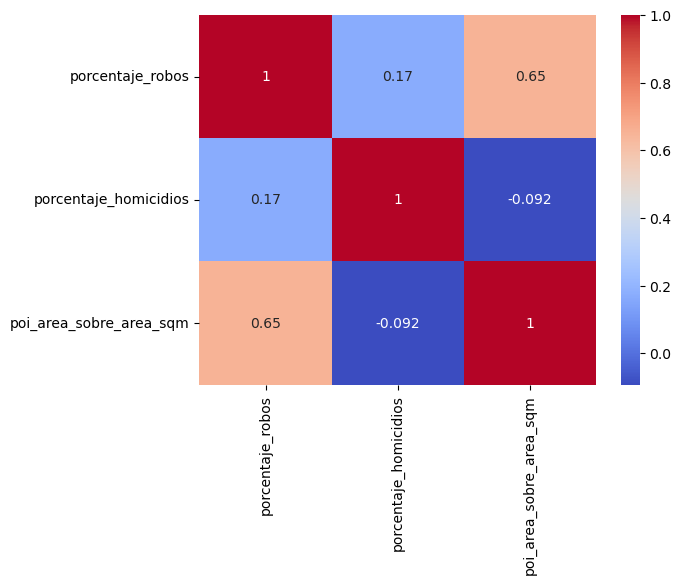

In [166]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(correlation, annot=True, cmap='coolwarm')
plt.show()